## Welcome to Week 4, Single Cell RNA!

### In this week, we're going to focus on the basics of single cell RNA analysis, including dimensionality reduction and opitional doublet detection and cell type identification/cell surface protein integration.

<u>First</u>, we'll have an introduction to the main Python package used for single cell analysis - **Scanpy**, developed by Fabian Theis's lab at the Helmholtz Zentrum München. The main publication for Scanpy is here, if you're curious:
* https://genomebiology.biomedcentral.com/articles/10.1186/s13059-017-1382-0?optIn=true

We're going to start with the output of the 10X Genomics cellranger pipeline, which is used for processing of single cell RNA data generated using droplet-based capture. You can read more about how single cell RNA sequencing and the cellranger pipeline work here (and we may do a cellranger tutorial later if there is interest:  
* https://www.10xgenomics.com/products/single-cell/?src=search&lss=google&cnm=sem-goog-2020-website-page-ra_g-p_brand-amr-retarget&cid=7011P000000oWys (videos at the end)
* https://support.10xgenomics.com/single-cell-gene-expression/software/overview/welcome  

Note though that you can also start with many other formats: the simplest being just a cells x genes counts table, but many other formats as well.  One thing that has become increasingly common is that there's a few labs that have really pushed the bounds of single-cell analysis with many, many cells - hundred thousands to millions of cells.  In many cases, these groups (e.g. Sten Linnarsson, Allen Brain Atlas) have introduced their own file formats for dealing with such large datasets efficiently (.loom, .tome, respectively), and there's specific functions for importing other dataset formats:

* https://icb-scanpy.readthedocs-hosted.com/en/stable/api/index.html#reading

The main idea is that single cells are captured in oil-water emulsion droplets along with barcoded oligos, which tag RNA transcripts with a unique cellular barcode during reverse transcription. After sequencing, the cellranger pipeline aligns the transcripts and matches them back to the cellular barcode to obtain counts for each transcript that was expressed for each cell. The main output that we will use from the cellranger pipeline is the **feature/cell matrix**, which is a matrix of cells by genes, where the values are the number of transcripts that were detected for that cell.  

Single cell methods are not perfect, and one of the main things we have to deal with is **dropout**, which occurs when a transcript is expressed by a cell but is not recovered by single cell sequencing. Lowly expressed genes are more likely to be affected by dropout. For 10X datasets, typically we can expect to detect 1000-2000 genes per cell. The main approach that has been developed to deal with dropout during single cell analysis is dimensionality reduction. The main steps we will take in Seurat are:
1. **Filter** cells based on QC metrics (number of genes detected, percent mitochondrial genes, etc.)
2. **Normalize** data
3. Identify **variable** genes to use for principal component analysis (PCA)
4. **Scale** data and regress out unwanted sources of variation (i.e. cell cycle)
5. **PCA** dimensionality reduction
6. **Cluster** cells to find nearest neighbors in PCA space (typically corresponding to different cell types/states)
7. Visualize cells using **UMAP/TSNE** non-linear dimensionality reduction
8. Find **differentially expressed** genes between clusters
9. **Cluster annotation**  

There is obviously a lot we can do after this but these steps are common to any single cell project. To get started we will be using this publically available human PBMC dataset from 10X:
* https://support.10xgenomics.com/single-cell-vdj/datasets/3.0.0/vdj_v1_hs_pbmc2_5gex_protein  

Go ahead and download the **Feature / cell matrix (filtered)**. Unpack the tar.gz file either using Finder or with this command in terminal:  
`tar -xzf vdj_v1_hs_pbmc2_5gex_protein_filtered_feature_bc_matrix.tar.gz`  

You can also take a look at the **Summary HTML** which has the QC metrics from the cellranger pipeline. We will now be following the Scanpy Guided Clustering Tutorial found here (but using the larger PBMC dataset we just downloaded):
* https://scanpy-tutorials.readthedocs.io/en/latest/pbmc3k.html

In [1]:
%%bash

cd /Users/kevin/changlab/github/Bioinformatics-Tutorials/wk4_scRNA/data
wget http://cf.10xgenomics.com/samples/cell-vdj/3.0.0/vdj_v1_hs_pbmc2_5gex_protein/vdj_v1_hs_pbmc2_5gex_protein_filtered_feature_bc_matrix.tar.gz

tar -xzf vdj_v1_hs_pbmc2_5gex_protein_filtered_feature_bc_matrix.tar.gz
rm vdj_v1_hs_pbmc2_5gex_protein_filtered_feature_bc_matrix.tar.gz

--2020-05-09 12:42:24--  http://cf.10xgenomics.com/samples/cell-vdj/3.0.0/vdj_v1_hs_pbmc2_5gex_protein/vdj_v1_hs_pbmc2_5gex_protein_filtered_feature_bc_matrix.tar.gz
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 99.84.230.116, 99.84.230.85, 99.84.230.86, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|99.84.230.116|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 49812550 (48M) [application/x-tar]
Saving to: ‘vdj_v1_hs_pbmc2_5gex_protein_filtered_feature_bc_matrix.tar.gz’

     0K .......... .......... .......... .......... ..........  0% 1.19M 40s
    50K .......... .......... .......... .......... ..........  0% 9.71M 22s
   100K .......... .......... .......... .......... ..........  0% 3.19M 20s
   150K .......... .......... .......... .......... ..........  0% 16.1M 16s
   200K .......... .......... .......... .......... ..........  0% 2.85M 16s
   250K .......... .......... .......... .......... ..........  0% 82.6M 13s
   300K .......... 

In [2]:
%%bash

cd /Users/kevin/changlab/github/Bioinformatics-Tutorials/wk4_scRNA/data/filtered_feature_bc_matrix/
ls 

barcodes.tsv.gz
features.tsv.gz
matrix.mtx.gz


## Installing Packages

We're going to be using **scanpy** to do the scRNA analysis.  You'll need to install scanpy (https://icb-scanpy.readthedocs-hosted.com/en/stable/installation.html) by running (in terminal):

       conda install -c bioconda scanpy

You'll also want to make sure that AnnData is installed, which is the package that contains the AnnData datatype (https://icb-anndata.readthedocs-hosted.com/en/stable/anndata.AnnData.html).  This is the datatype that we use to store single-cell data. In addition, you'll also want to install the Leiden clustering package as well:

        conda install -c conda-forge leidenalg anndata
        
If you want to try Scrublet (doublet detection, https://github.com/AllonKleinLab/scrublet), then run:

        conda install -c bioconda scrublet

## What if you get stuck?

If you get stuck - you don't know what the function you should use is, or what arguments/paramters it has, the first places you should look are the tutorials and documentation/API for scanpy:

* https://scanpy.readthedocs.io/en/latest/api/index.html
* https://scanpy.readthedocs.io/en/latest/tutorials.html

In the API, you can find all of the information on what tools are available, how to use them, and 

## A note on Scanpy vs. Seurat

Scanpy is probably less common than Seurat at the moment, but I think this is mostly because Seurat came first.  Scanpy has been gaining more and more usage, and I've started to see it used a little more frequently (you can sometimes tell who is using what based on how their figures look, just with default plotting formats), in addition to noticing a lot of web-based analysis tools starting to use Scanpy.  I think it's better at dealing with large datasets, and as people are starting to develop more and more tools in Python, I think it's only going to become more commonly used.

**I (Kevin) have mostly used Seurat, but the more that I've used Scanpy the more that I've been impressed.**  Pros:
- Scanpy runs significanlty faster, especially with larger datasets
- Scanpy has implemented a lot of other useful tools (like pseudotime trajectories) and integrates with a lot of other tools (like RNA velocity)
- The built-in plotting functions (https://scanpy-tutorials.readthedocs.io/en/latest/visualizing-marker-genes.html) are very impressive and I think blow Seurat's out of the water in terms of options and ease of use.
- I've also really been impressed with the documentation for all of the functions and arguments, which I think is one thing that Seurat is often lacking - their vignettes are nice, but their general documentation is often pretty poor.

### So while I still think Seurat is the primary tool for scRNA analysis just because it's been around longer, I think Scanpy is gaining a lot of momentum and I feel really good about recommending it, and am probably going to start using it more myself.

## Import data

Note that this data contains both *RNA* and *CITE-seq* information.  We're going to start with just the RNA data.

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib as mpl
from matplotlib import pyplot as plt
from scipy.sparse import csr_matrix

/anaconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


In [2]:
path = '/Users/kevin/changlab/github/Bioinformatics-Tutorials/wk4_scRNA/data/filtered_feature_bc_matrix/'
figpath = '/Users/kevin/changlab/github/Bioinformatics-Tutorials/wk4_scRNA/figures_python/'

# lets set the default figure settings

sc.settings.set_figure_params(dpi_save=300, dpi=300)
sc.settings.figdir = figpath

In [11]:
# If we wanted to import all of the data, then we would run
orig = sc.read_10x_mtx(path, gex_only=False)
print(orig)

gex_genes = orig.var.index[orig.var['feature_types'] == 'Gene Expression']
cite_genes = orig.var.index[orig.var['feature_types'] == 'Antibody Capture']

print('gex', len(gex_genes))
print('cite', len(cite_genes))

AnnData object with n_obs × n_vars = 8258 × 33555 
    var: 'gene_ids', 'feature_types'
gex 33538
cite 17


In [37]:
# Since we are only going to deal with the gene expression data for now, we'll say

gex = sc.read_10x_mtx(path, gex_only=True)
print(gex)

View of AnnData object with n_obs × n_vars = 8258 × 33538 
    var: 'gene_ids', 'feature_types'


Just to match the Seurat filtering (only including genes that are in at least 3 cells; and only including cells that have at least 200 genes), we'll say:

In [38]:
sc.pp.filter_cells(gex, min_genes=200)
sc.pp.filter_genes(gex, min_cells=3)

print(gex)

Trying to set attribute `.obs` of view, copying.


AnnData object with n_obs × n_vars = 8214 × 17961 
    obs: 'n_genes'
    var: 'gene_ids', 'feature_types', 'n_cells'


### The rest of the tutorial I will leave for you to fill in!  
There are a couple of important pivot points that you can modify for your data which I will break up by processing step:
1. **Filter**  
   a. `n_genes`: How many genes are detected per cell. We're going to use 200 as a minimum here, but try raising this lower or higher. You generally want to set this by checking the distribution in your data, and cutting off the bottom tail. Cells with fewer than ~200 genes detected typically don't have enough information to cluster on, and often will end up as just their own cluster if you don't filter them out.  
   b. `n_counts`: How many UMIs or transcripts detected per cell. I typically don't filter using this metric as it is linearly correlated with nFeature_RNA. Some people will use an upper threshold here to try and filter out doublets but typically is not robust and we describe alternative approaches below.  
   c. `percent_mito`: Percent mitochondrial transcripts. Dying cells will have more mitochondrial gene content and so this can be used to filter low quality cells. Check the distribution in your data but typically upper thresholds of 5-20% mitochondrial content make sense.
2. **Normalize** - I use the defaults pretty much always.
3. **Variable genes** - Not a lot to modify here. If you have residual batch/unwanted variation (like cell cycle) effects after regression you can remove these genes from the variable gene set. Sometimes I also observed clustering based on variable immune genes (like TCR/Ig transcripts) so these can be removed as well.
4. **Regressing out unwanted effects** - If you have batch effects/sources of unwanted variation like cell cycle effects you can regress them out here. Some other common variables to regress are n_genes or n_counts (which are generally highly correlated), percent_mito.  It's usually best to make a first pass through your data without regressing out any variables, and then visualize the distribution of counts/genes/mito across your cells.  Then, if you observe clustering based on these features (and/or low quality cells), try regressing them out (and/or removing low quality cells).
5. **Scale** - Not a lot to modify here either.
6. **PCA**  
7. **Clustering and UMAP**
   a. `n_pcs`: Pick how many dimensions to use for PCA. Including more PCs is usually better than too few, so I would err with too more than too few. Between 20-50 PCs is typically appropriate.
   a. `resolution`: Argument to the FindClusters function. This is a big one you can change. Higher resolution values will give more clusters, lower resolution values give fewer clusters. How many clusters you want depends on the biological variation in your data as well as how you want to analyze it (are broad cell types enough or do you want specific cell states?). Values between 0.4-1.2 are typically appropriate. 
  - UMAP is superior to TSNE in many ways so I won't talk about TSNE.  
   a. `min.dist`: This will change how spread out the UMAP is with lower values pulling cells apart more. This is useful for closely related cells that may not seperate well in the UMAP using the default parameters.

### Make QC violin plots and filter cells

In [39]:
mito_genes = gex.var_names.str.startswith('MT-')

gex.obs['percent_mito'] = np.sum(
    gex[:, mito_genes].X, axis=1).A1 / np.sum(gex.X, axis=1).A1

gex.obs['n_counts'] = gex.X.sum(axis=1).A1

... storing 'feature_types' as categorical


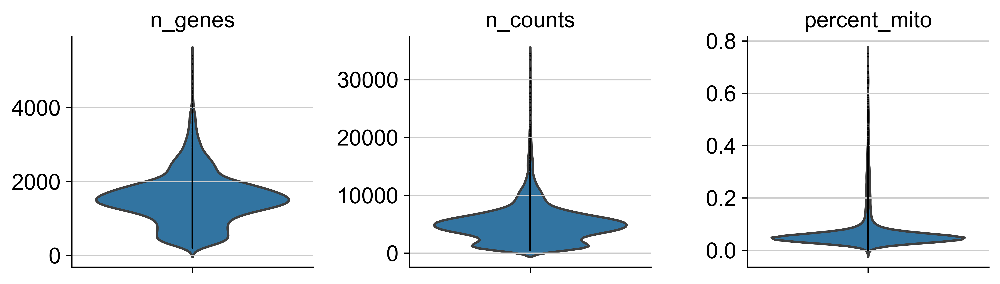

In [40]:
sc.pl.violin(gex, ['n_genes', 'n_counts', 'percent_mito'],
             multi_panel=True, jitter=False, save='1_QC_violin.png')

In [41]:
print(gex)

gex = gex[gex.obs.n_genes >= 200, :]
gex = gex[gex.obs.percent_mito < 0.1, :]

print(gex)

AnnData object with n_obs × n_vars = 8214 × 17961 
    obs: 'n_genes', 'percent_mito', 'n_counts'
    var: 'gene_ids', 'feature_types', 'n_cells'
View of AnnData object with n_obs × n_vars = 7251 × 17961 
    obs: 'n_genes', 'percent_mito', 'n_counts'
    var: 'gene_ids', 'feature_types', 'n_cells'


### Normalize the data

In [42]:
sc.pp.normalize_total(gex, target_sum=1e4)
sc.pp.log1p(gex)
gex.raw = gex

/anaconda3/lib/python3.6/site-packages/scanpy/preprocessing/_simple.py:285: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(data)


### Find variable genes

In [43]:
sc.pp.highly_variable_genes(gex, n_top_genes=2000)

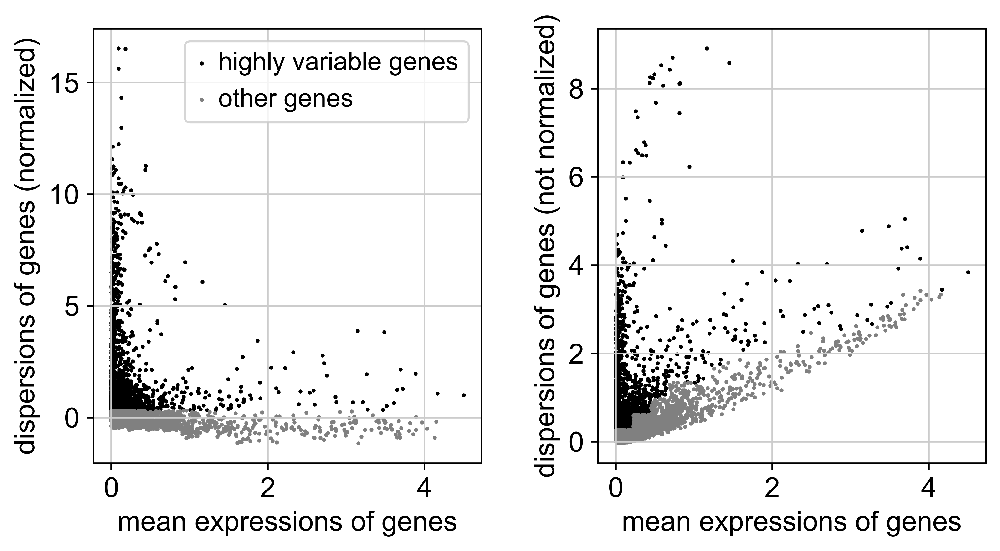

In [44]:
sc.pl.highly_variable_genes(gex, save='2_variable-genes.png')

In [45]:
gex = gex[:, gex.var.highly_variable]

### Optional: regress out any confounding variables

In [46]:
# sc.pp.regress_out(gex, ['n_genes'])

### Scale your data

In [47]:
sc.pp.scale(gex, max_value=10)

/anaconda3/lib/python3.6/site-packages/scanpy/preprocessing/_simple.py:869: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


### Perform PCA

In [48]:
sc.tl.pca(gex, svd_solver='arpack')

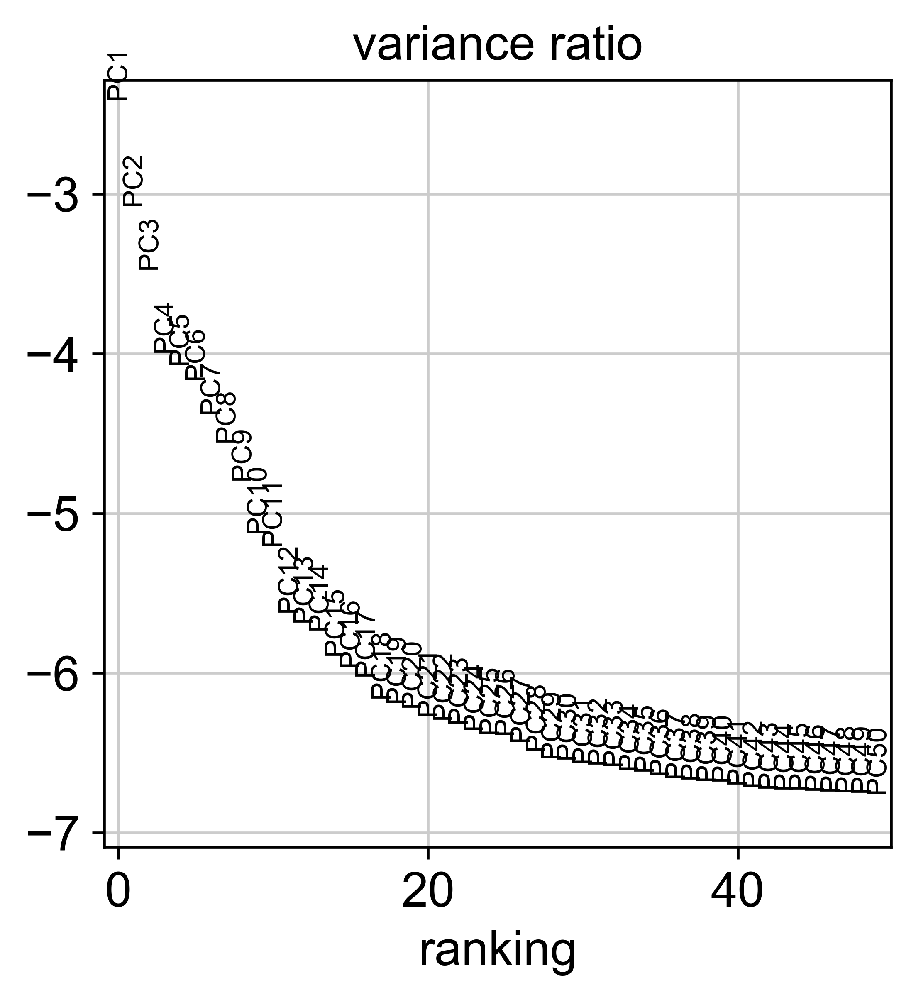

In [49]:
sc.pl.pca_variance_ratio(gex, log=True, n_pcs=50, save='3_PCA-variance-loadings.png')

### Cluster your data, get a UMAP embedding, and plot the results

In [50]:
sc.pp.neighbors(gex, n_neighbors=10, n_pcs=50, random_state=1)

In [51]:
sc.tl.leiden(gex, random_state=1, resolution=.2)

In [52]:
sc.tl.umap(gex)

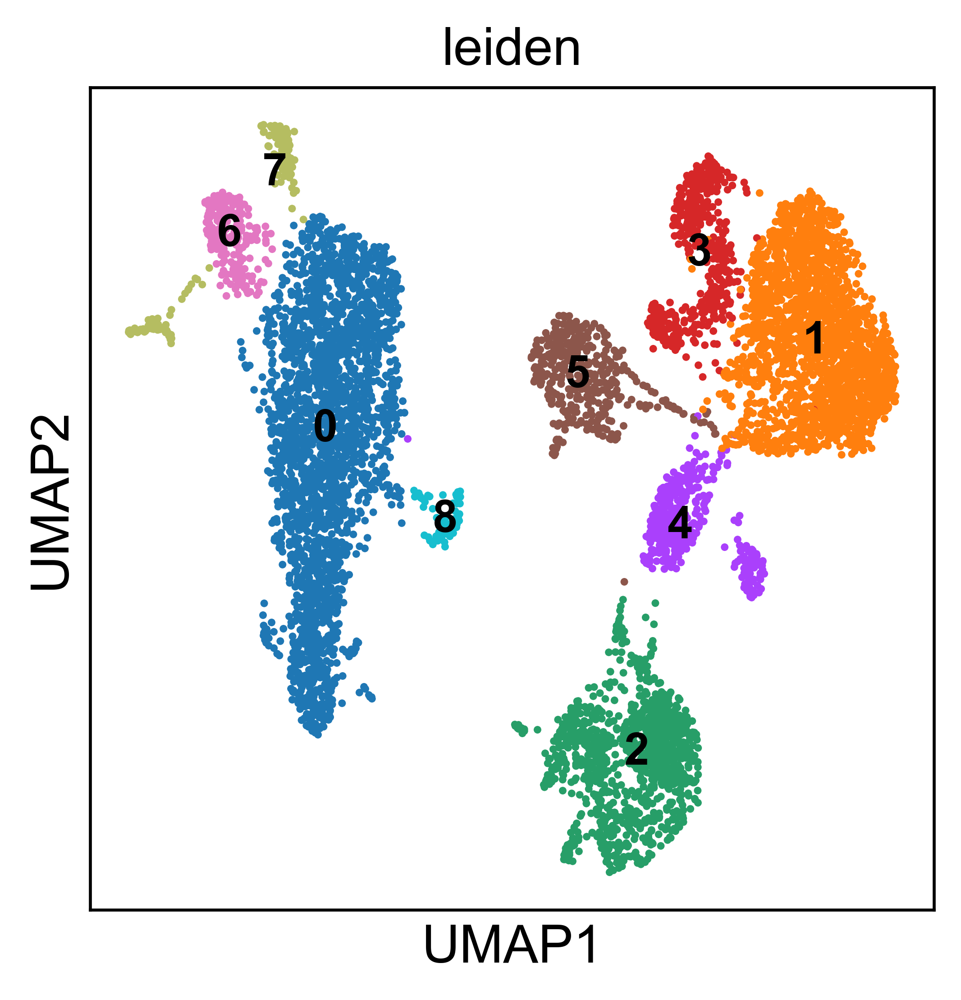

In [53]:
fig = sc.pl.umap(gex, color=['leiden'],
                legend_fontsize = 12,
                legend_loc = 'on data', save='4_UMAP_clustering.png')

### Plot some common marker genes

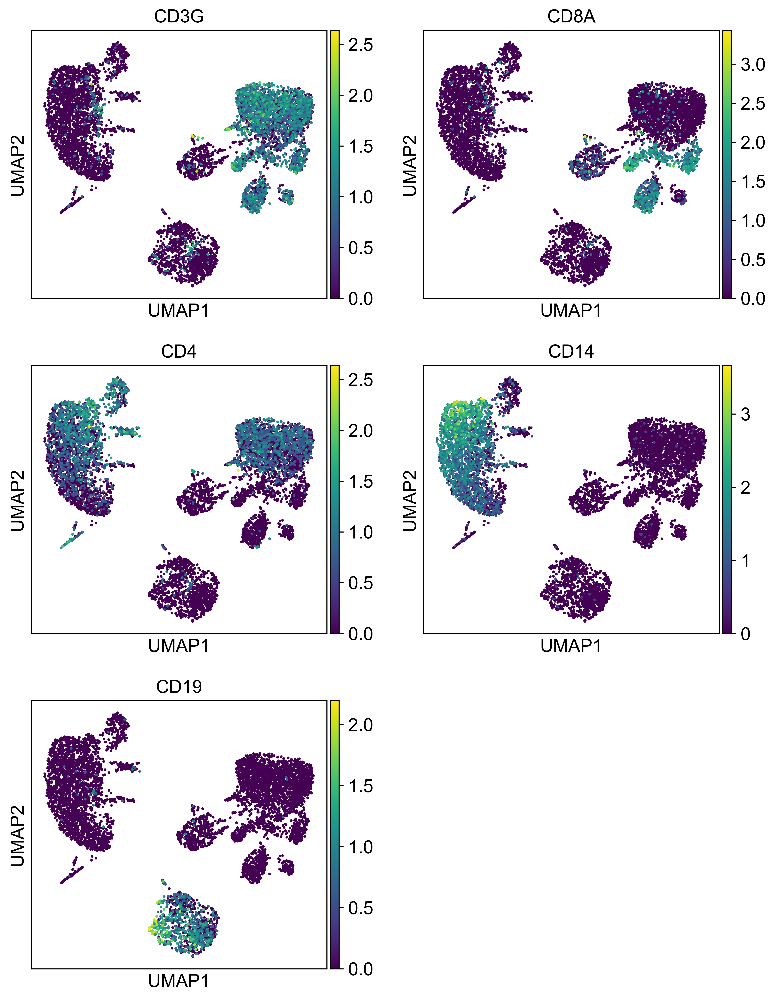

In [27]:
genes_to_plot = ['CD3G','CD8A','CD4','CD14','CD19']

sc.pl.umap(gex, color=genes_to_plot, use_raw=True,
                sort_order=True, ncols=2, save = '4_UMAP_genes.png')

## Additional steps: Finding marker genes and annotating clusters

Congrats on finishing the Scanpy tutorial! There are a few things you can do now to explore the data:
1. Check `n_genes`, `n_counts` amd `percent_mito` for each cluster using the `pl.violin` function. Do any clusters look like low quality cells?
2. Check for cell cycle effects by checking expression of cell cycle associated genes using the `pl.violin` function or looking for cell cycle genes in the cluster markers called by `tl.rank_genes_groups`. If cell cycle effects are present they can be regressed out using this vignette:  
https://nbviewer.jupyter.org/github/theislab/scanpy_usage/blob/master/180209_cell_cycle/cell_cycle.ipynb
3. Annotate cell clusters based on expression of marker genes. You can check expression using either the `pl.rank_genes_groups`, `pl.rank_genes_groups_stacked_violin`, `pl.stacked_violin`, `pl.umap`, and other functions. All are useful, just depends on your preference! Here are couple of good markers for PBMCs:  
   a. T cells: CD3G, CD3E, CD3D  
   b. Cytotoxic CD8+ T cells: CD8A  
   c. Helper CD4+ T cells: CD4  
   d. Naive T cells: CCR7  
   e. Memory CD8+ cells: EOMES  
   f. Effector memory CD8+ T cells: KLRD1  
   g. B cells: CD19, MS4A1  
   h. Monocytes: CD14, FCGR3A  
   i. NK cells: GNLY, NKG7 (CD3-, NK cells and cytotoxic T cells share many markers and may cluster together)  
   j. Platelets: PPBP
4. Subset a broad cell type and recluster to find more accurate subtypes. For example, subset all T cell clusters and recluster starting from data scaling and variable gene detection. Do you find more clusters? How do they compare to the original clusters you found using all PBMCs?
5. Make sure you save your Scanpy object (`gex`) so it can be loaded again using the .write() function built in to the anndata (gex) object. Also try saving some plots as PDFs or PNGs and tables (like the cluster markers) as text files.

**Extra challenge**: This dataset also has CITE-seq surface protein data! Try adding this data to your Seurat object (Hint look back at the `sc.read_10x_mtx` we read in at the beginning). Which proteins were analyzed? How does protein expression compare to RNA expression? See more details in the vignette here:  
https://icb-scanpy-tutorials.readthedocs-hosted.com/en/multiomics/cite-seq/pbmc5k.html

In [20]:
sc.tl.rank_genes_groups(gex, 'leiden', method='t-test',
                       n_genes=25)

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/rank_genes_groups_leiden5_marker-genes-ranking.png


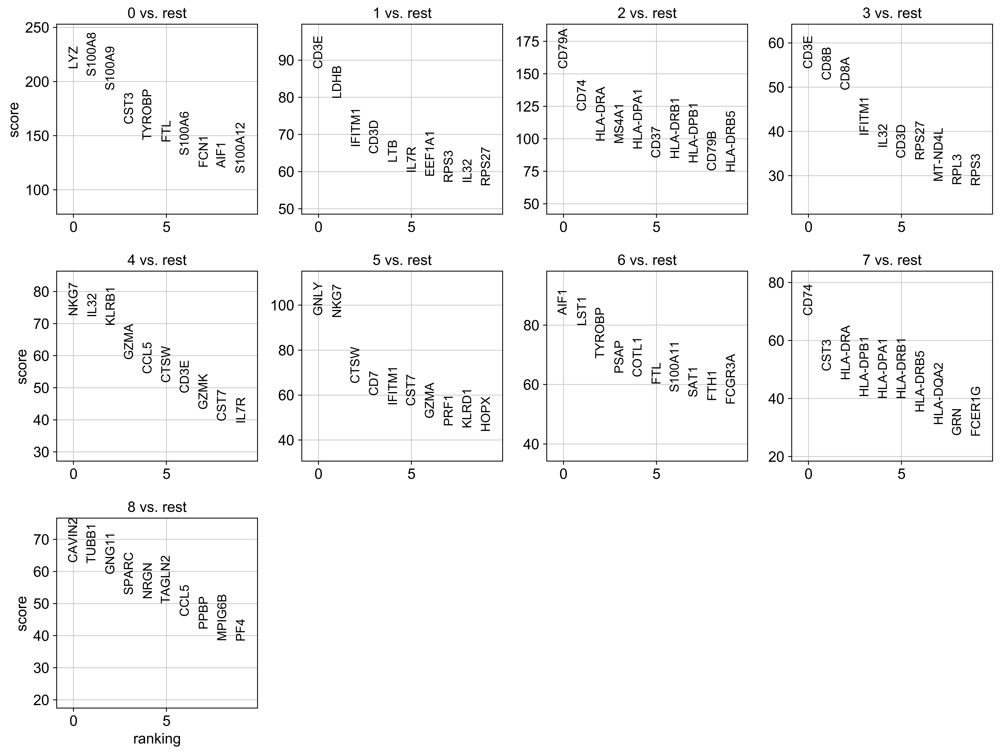

In [21]:
sc.pl.rank_genes_groups(gex, n_genes=10, sharey=False,
                        fontsize=12,
                        save='5_marker-genes-ranking.png')

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/stacked_violin5_marker_genes-violin.png


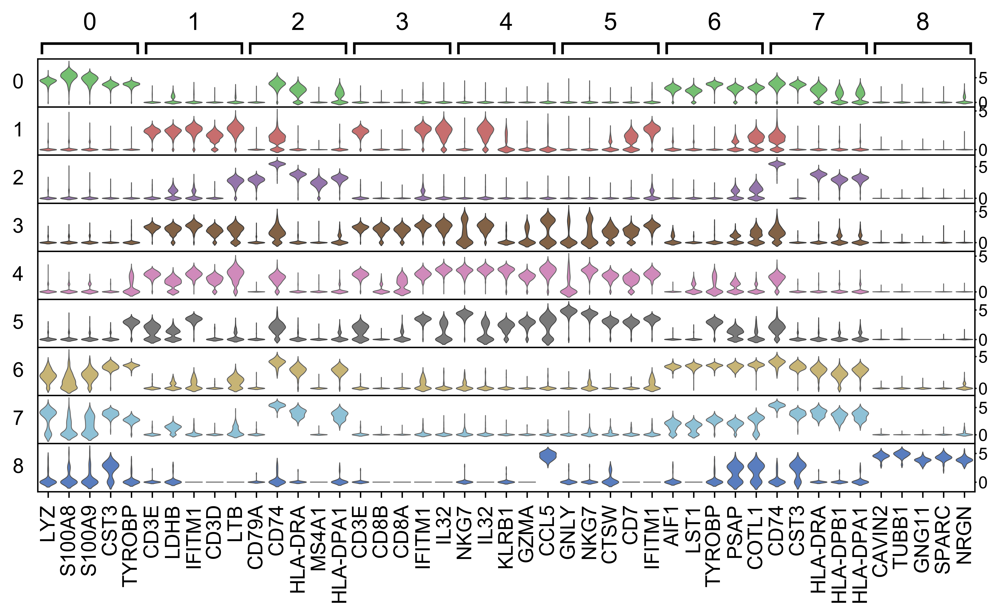

In [22]:
sc.pl.rank_genes_groups_stacked_violin(gex,
                              n_genes=5, dendrogram=False,
                                      save='5_marker_genes-violin.png')

In [25]:
# since we know markers, let's make panels for some cell types that we expect to see

t_cell_panel = ['CD3E','CD8A','CD4','CCR7','EOMES','KLRD1']
b_cell_panel = ['CD79A','CD19','MS4A1']
monocyte_panel = ['CD14','LYZ','FCGR3A','MS4A7']
nk_panel = ['GNLY','NKG7']
dc_panel = ['FCER1A','CST3']
platelet_panel = ['PPBP']

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/stacked_violin6_violin_T-NK.png


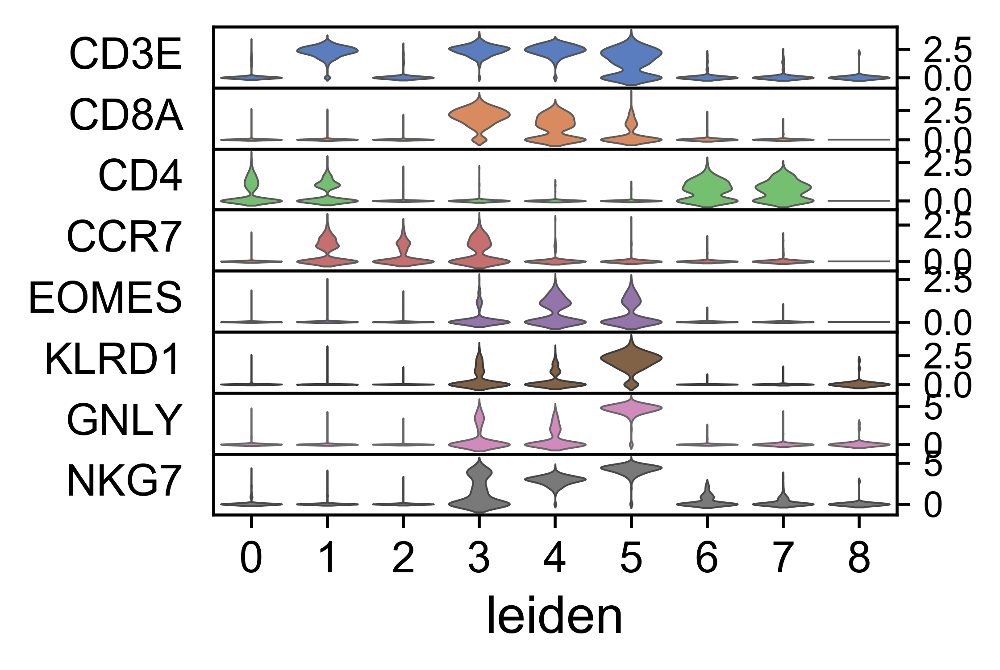

In [26]:
# t cells + NK cells

# cluster 1, 3, 4 = t cells
# cluster 6, 7 = monocytes (low cd4 but no cd8)

# cluster 1 = naive CD4 t cells
# cluster 3 = CD8 T cells
# cluster 4 = CD8 Tem
# cluster 5 = NK cells

sc.pl.stacked_violin(gex, t_cell_panel + nk_panel, groupby='leiden', swap_axes=True,
                    save='6_violin_T-NK.png')

plt.show()

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/stacked_violin6_violin_B.png


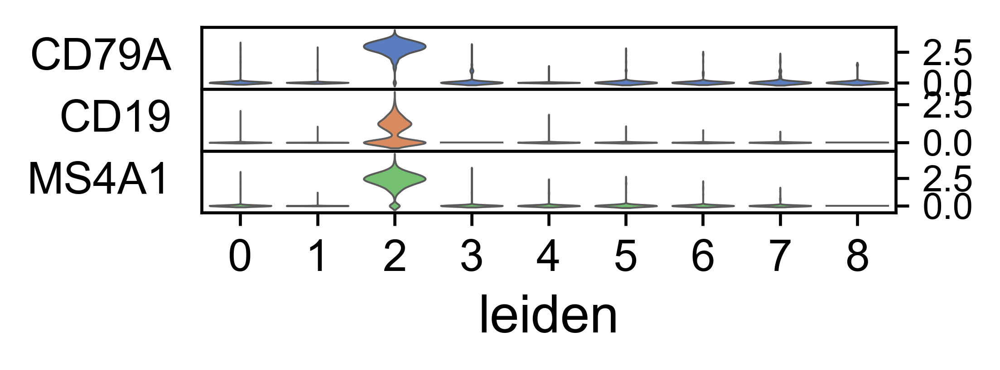

In [27]:
# b cells

# cluster 2 = b cells

sc.pl.stacked_violin(gex, b_cell_panel, groupby='leiden', swap_axes=True, save='6_violin_B.png')
plt.show()

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/stacked_violin6_violin_monocyte.png


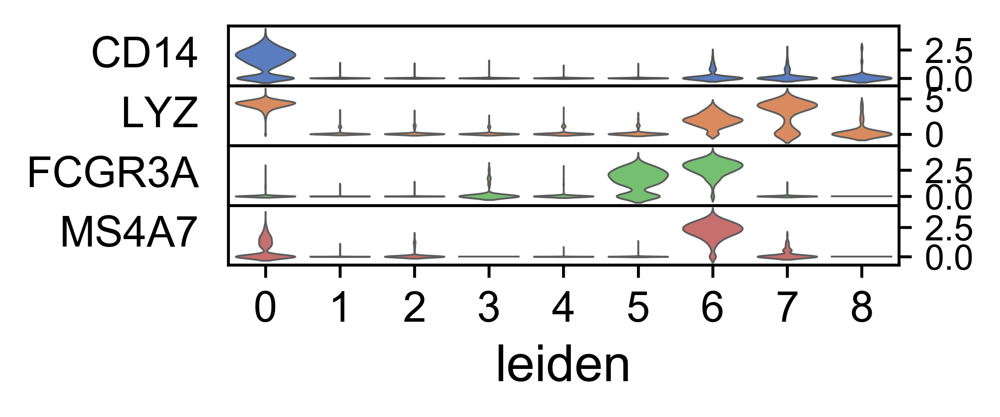

In [28]:
# monocytes

# cluster 0 = CD14+ monocytes
# cluster 6 = FCGR3A+ Mono

sc.pl.stacked_violin(gex, monocyte_panel, groupby='leiden', swap_axes=True, save='6_violin_monocyte.png')
plt.show()

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/stacked_violin6_violin_DC.png


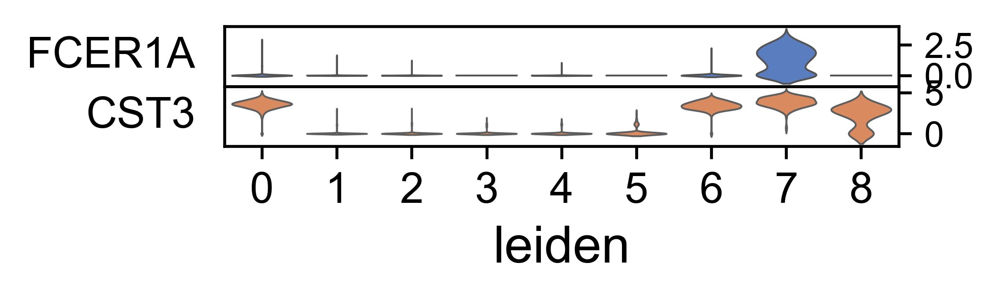

In [29]:
# cluster 7 is DCs

sc.pl.stacked_violin(gex, dc_panel, groupby='leiden', swap_axes=True, save='6_violin_DC.png')
plt.show()

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/stacked_violin6_violin_platelet.png


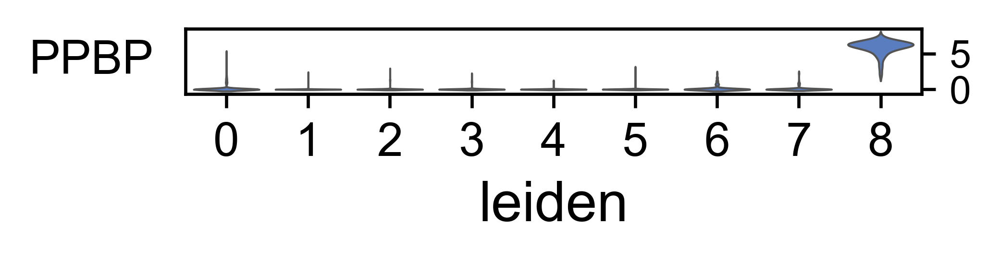

In [30]:
# cluster 8 is platelets

sc.pl.stacked_violin(gex, platelet_panel, groupby='leiden', swap_axes=True, save='6_violin_platelet.png')
plt.show()

In [173]:
"""
CLUSTER IDS

0 CD14+ monocytes
1 Naive CD4+ T cells
2 B cells
3 CD8+ T cells
4 CD8+ T cells
5 NK cells
6 FCGR3A+ monocytes
7 Dendritic cells
8 Platelets

"""

'\nCLUSTER IDS\n\n0 CD14+ monocytes\n1 Naive CD4+ T cells\n2 B cells\n3 CD8+ T cells\n4 CD8+ T cells\n5 NK cells\n6 FCGR3A+ monocytes\n7 Dendritic cells\n8 Platelets\n\n'

In [31]:
new_cluster_names = ['CD14 Mono',
                    'CD4 T ',
                    'B',
                    'CD8 T',
                    'CD8 Tem',
                    'NK',
                    'FCGR3A Mono',
                    'DCs',
                    'Platelets']
gex.rename_categories('leiden', new_cluster_names)

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/umap7_UMAP-clusters-labeled.png


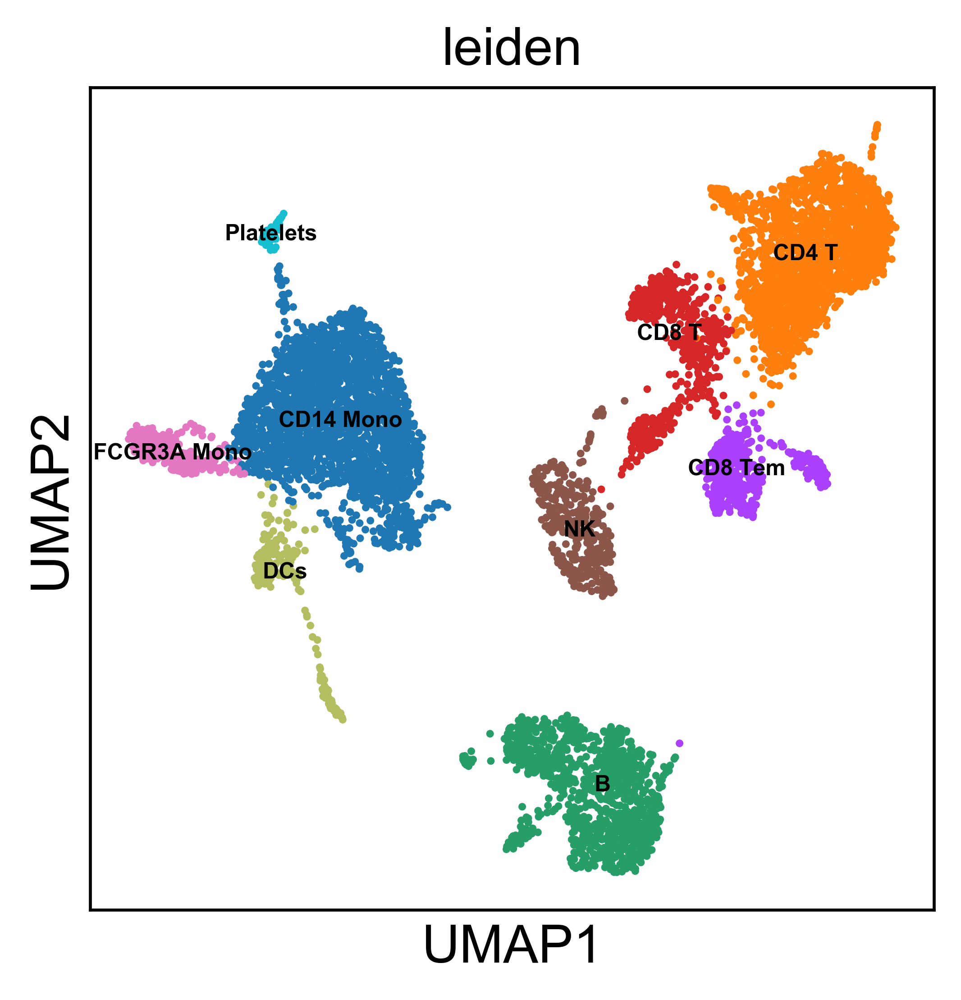

In [33]:
sc.pl.umap(gex, color='leiden', legend_loc='on data',
          legend_fontsize=6, save='7_UMAP-clusters-labeled.png')

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/umap7_UMAP-clusters-genes.png


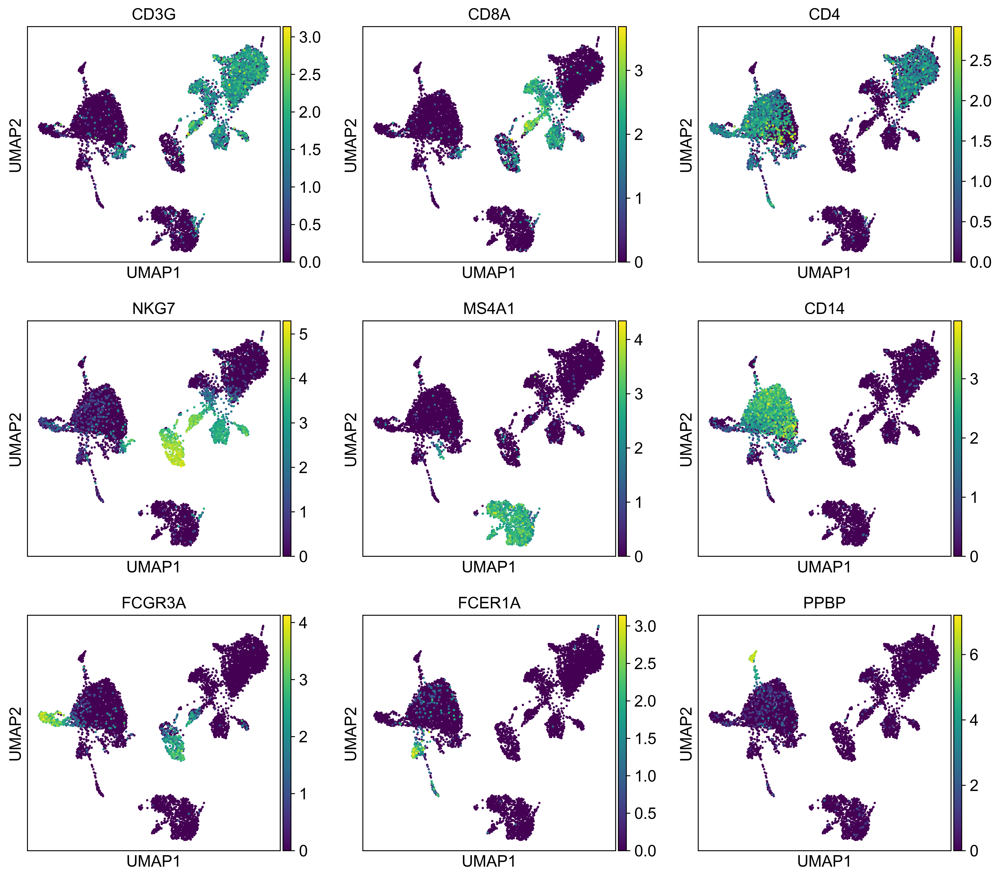

In [35]:
genes_to_plot = ['CD3G','CD8A','CD4',
                 'NKG7','MS4A1','CD14',
                 'FCGR3A','FCER1A','PPBP']

sc.pl.umap(gex, color=genes_to_plot, use_raw=True,
                sort_order=True, ncols=3, save='7_UMAP-clusters-genes.png')

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/stacked_violin8_violin.png


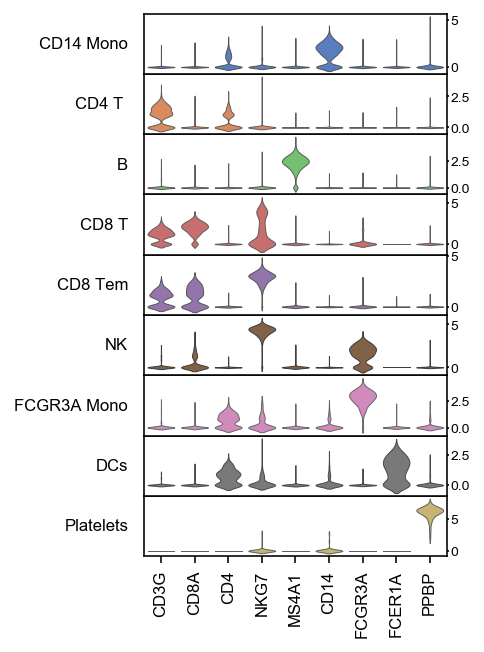

In [58]:
sc.pl.stacked_violin(gex, genes_to_plot, dendrogram=False,
                    groupby='leiden', save='8_violin.png')

plt.show()

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/dotplot8_dotplot.png


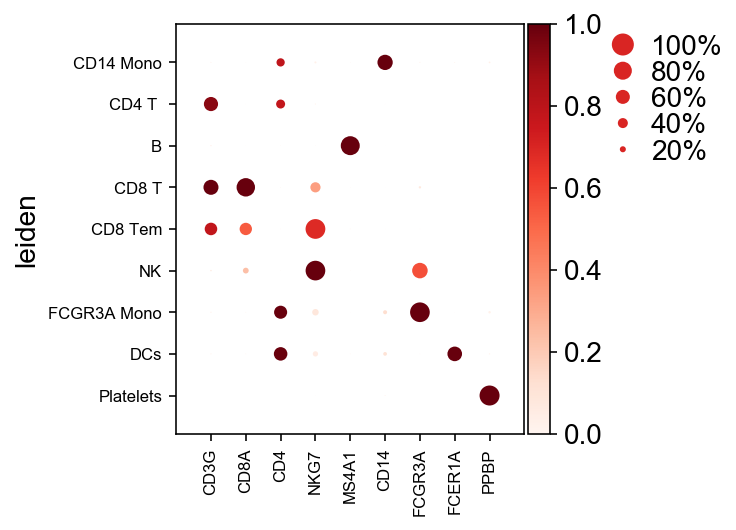

In [59]:
sc.pl.dotplot(gex, genes_to_plot, groupby='leiden', standard_scale='var', save='8_dotplot.png')
plt.show()

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/matrixplot8_heatmap-grouped.png


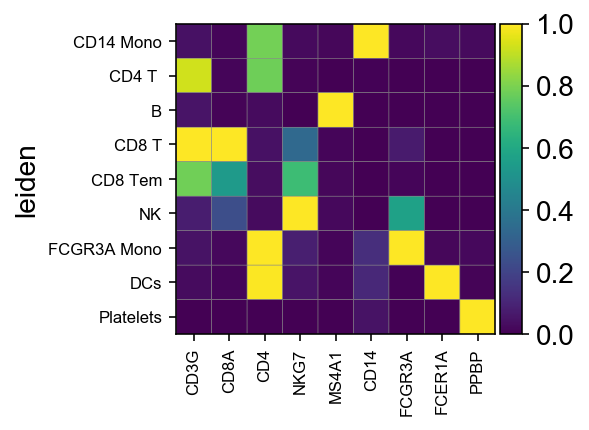

In [60]:
sc.pl.matrixplot(gex, genes_to_plot, groupby='leiden', standard_scale='var', save='8_heatmap-grouped.png')
plt.show()

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/heatmap8_heatmap_cells.png


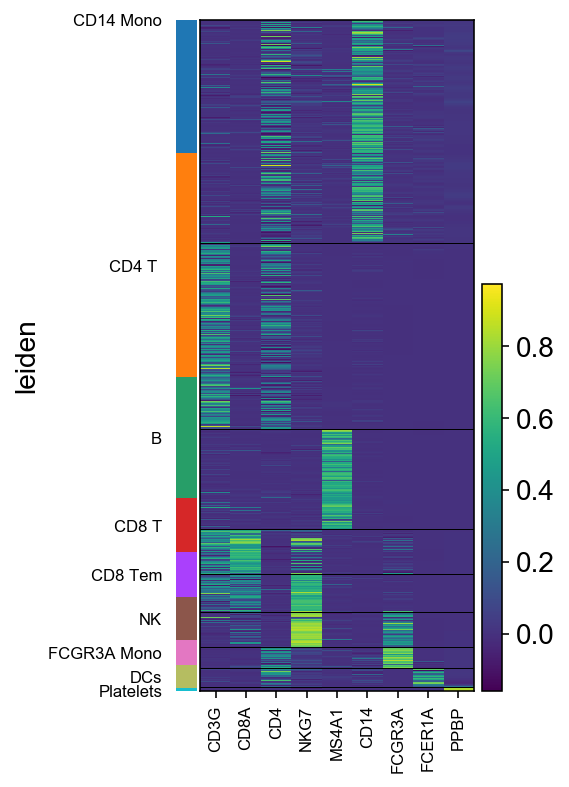

In [61]:
sc.pl.heatmap(gex , genes_to_plot, groupby='leiden', standard_scale='var', save='8_heatmap_cells.png')
plt.show()

saving figure to file /Users/kevin/changlab/covid19/3_scRNA/figures/tracksplot8_trackplot.png


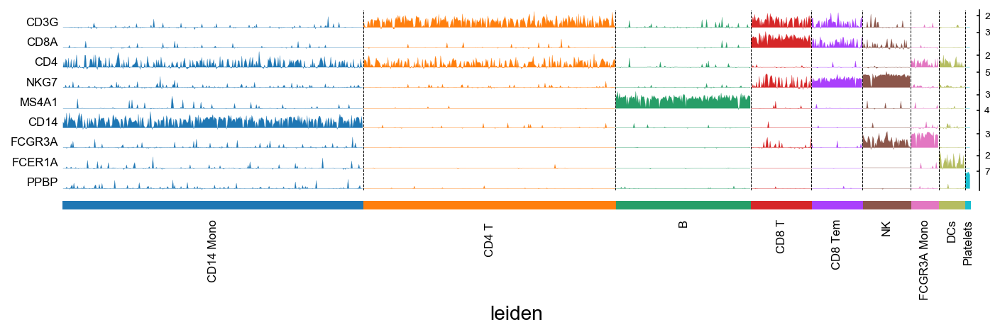

In [62]:
sc.pl.tracksplot(gex ,genes_to_plot, groupby='leiden', save='8_trackplot.png')
plt.show()

## Now let's deal with doublets, and also try regressing out some confounding variables.

See https://github.com/AllonKleinLab/scrublet, https://github.com/AllonKleinLab/scrublet/blob/master/examples/scrublet_basics.ipynb for examples.

In [29]:
import scrublet as scr
import scipy.io

counts_matrix = scipy.io.mmread(path + '/matrix.mtx.gz').T.tocsc()

In [30]:
cells = pd.read_csv(path + '/barcodes.tsv.gz', sep='\t', header=None, names=['barcode'])
# cells['barcode'] = [i.split('-')[0] for i in cells['barcode']]
cells = cells.set_index('barcode', drop=False)
cells.head()

,barcode
barcode,
AAACCTGAGACCACGA-1,AAACCTGAGACCACGA-1
AAACCTGAGAGCAATT-1,AAACCTGAGAGCAATT-1
AAACCTGAGGCTCTTA-1,AAACCTGAGGCTCTTA-1
AAACCTGAGTGAACGC-1,AAACCTGAGTGAACGC-1
AAACCTGAGTTGTCGT-1,AAACCTGAGTTGTCGT-1


In [31]:
scrub = scr.Scrublet(counts_matrix, expected_doublet_rate=0.08)

In [32]:
doublet_scores, predicted_doublets = scrub.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.34
Detected doublet rate = 2.8%
Estimated detectable doublet fraction = 42.4%
Overall doublet rate:
	Expected   = 8.0%
	Estimated  = 6.7%
Elapsed time: 9.5 seconds


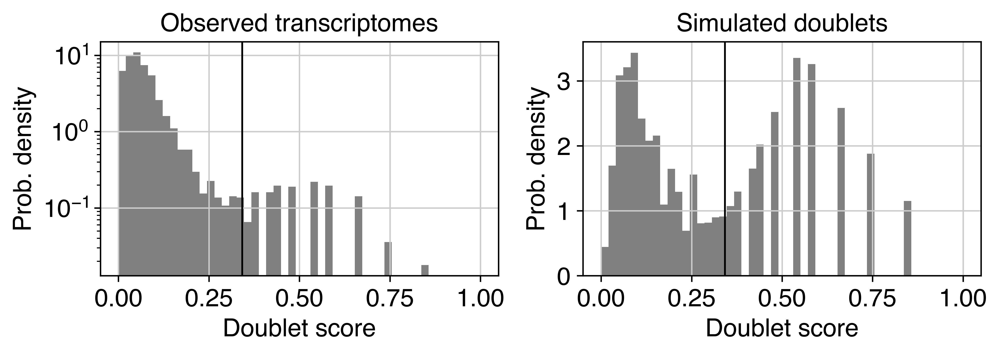

In [33]:
fig, _ = scrub.plot_histogram()

fig.savefig(figpath + 'scrublet_histogram.png', dpi=300, bbox_inches='tight')

In [34]:
predicted_doublets = scrub.call_doublets(threshold=0.25)

Detected doublet rate = 4.1%
Estimated detectable doublet fraction = 51.0%
Overall doublet rate:
	Expected   = 8.0%
	Estimated  = 8.0%


In [35]:
scrub.set_embedding('UMAP', scr.get_umap(scrub.manifold_obs_, 10, min_dist=0.3))

/anaconda3/lib/python3.7/site-packages/scrublet/scrublet.py:552: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
  cmap=cmap_use, vmin=vmin, vmax=vmax)
/anaconda3/lib/python3.7/site-packages/scrublet/scrublet.py:564: MatplotlibDeprecationWarning: Using a string of single character colors as a color sequence is deprecated. Use an explicit list instead.
  ax.scatter(x[o], y[o], s=marker_size, edgecolors='', c=called_doubs[o], cmap=custom_cmap([[.7,.7,.7], [0,0,0]]))


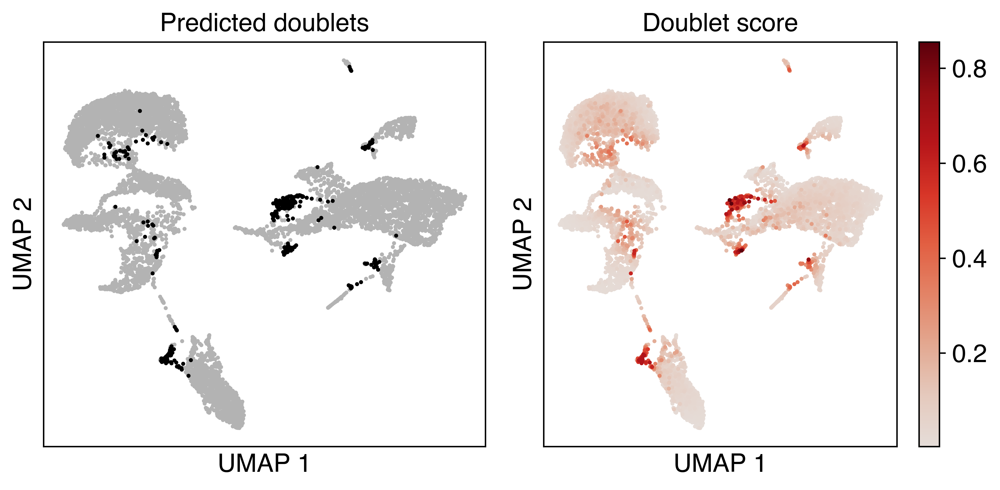

In [36]:
fig, _ = scrub.plot_embedding('UMAP', order_points=True)

# fig.savefig(figpath + 'scrublet_umap.png', dpi=300, bbox_inches='tight')

In [37]:
cells['doublet_score'] = doublet_scores
cells['predicted_doublet'] = predicted_doublets
cells.to_csv(figpath + 'scrublet_results.txt')
cells.head()

,barcode,doublet_score,predicted_doublet
barcode,,,
AAACCTGAGACCACGA-1,AAACCTGAGACCACGA-1,0.018230,False
AAACCTGAGAGCAATT-1,AAACCTGAGAGCAATT-1,0.052848,False
AAACCTGAGGCTCTTA-1,AAACCTGAGGCTCTTA-1,0.013077,False
AAACCTGAGTGAACGC-1,AAACCTGAGTGAACGC-1,0.054355,False
AAACCTGAGTTGTCGT-1,AAACCTGAGTTGTCGT-1,0.129426,False


In [234]:
# lets restart and add this to our data.

# Since we are only going to deal with the gene expression data for now, we'll say

gex = sc.read_10x_mtx(path, gex_only=True)
print(gex)

gex.obs['doublet_score'] = cells.loc[gex.obs.index, 'doublet_score']
gex.obs['predicted_doublet'] = cells.loc[gex.obs.index, 'predicted_doublet']

gex.obs.head()

AnnData object with n_obs × n_vars = 8258 × 33538 
    var: 'gene_ids', 'feature_types'


,doublet_score,predicted_doublet
AAACCTGAGACCACGA-1,0.018230,False
AAACCTGAGAGCAATT-1,0.052848,False
AAACCTGAGGCTCTTA-1,0.013077,False
AAACCTGAGTGAACGC-1,0.054355,False
AAACCTGAGTTGTCGT-1,0.129426,False


### Use your code from above to re-process everything.  If you want to subset your data to explicitly exclude the doublets, look back up at how we filtered based on # genes detected and % mitochondria for a hint as to how to set criteria for filtering cells.

I'd recommend first not excluding the doublets, and then making a UMAP plot and looking at how the results look with the doublet scores colored on each cell.  Where do the doublets fall? Do they tend to fall together?

In [235]:
sc.pp.filter_cells(gex, min_genes=200)
sc.pp.filter_genes(gex, min_cells=3)

mito_genes = gex.var_names.str.startswith('MT-')
gex.obs['percent_mito'] = np.sum(
    gex[:, mito_genes].X, axis=1).A1 / np.sum(gex.X, axis=1).A1
gex.obs['n_counts'] = gex.X.sum(axis=1).A1

print(gex)

gex = gex[gex.obs.n_genes >= 500, :]
gex = gex[gex.obs.percent_mito < 0.1, :]
# gex = gex[gex.obs.predicted_doublet == False]

print(gex)

sc.pp.normalize_total(gex, target_sum=1e4)
sc.pp.log1p(gex)
gex.raw = gex

AnnData object with n_obs × n_vars = 8214 × 17961 
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'percent_mito', 'n_counts'
    var: 'gene_ids', 'feature_types', 'n_cells'
View of AnnData object with n_obs × n_vars = 7027 × 17961 
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'percent_mito', 'n_counts'
    var: 'gene_ids', 'feature_types', 'n_cells'


/anaconda3/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:297: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(data)


In [236]:
sc.pp.highly_variable_genes(gex, n_top_genes=2000)
gex = gex[:, gex.var.highly_variable]

In [237]:
sc.pp.regress_out(gex, ['n_genes'])

/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1172: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


In [238]:
sc.pp.scale(gex, max_value=10)
sc.tl.pca(gex, svd_solver='arpack', n_comps=50)
sc.pp.neighbors(gex, n_neighbors=10, n_pcs=50, random_state=1)

In [239]:
sc.tl.leiden(gex, random_state=1, resolution=.4)

In [240]:
sc.tl.umap(gex)

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  """


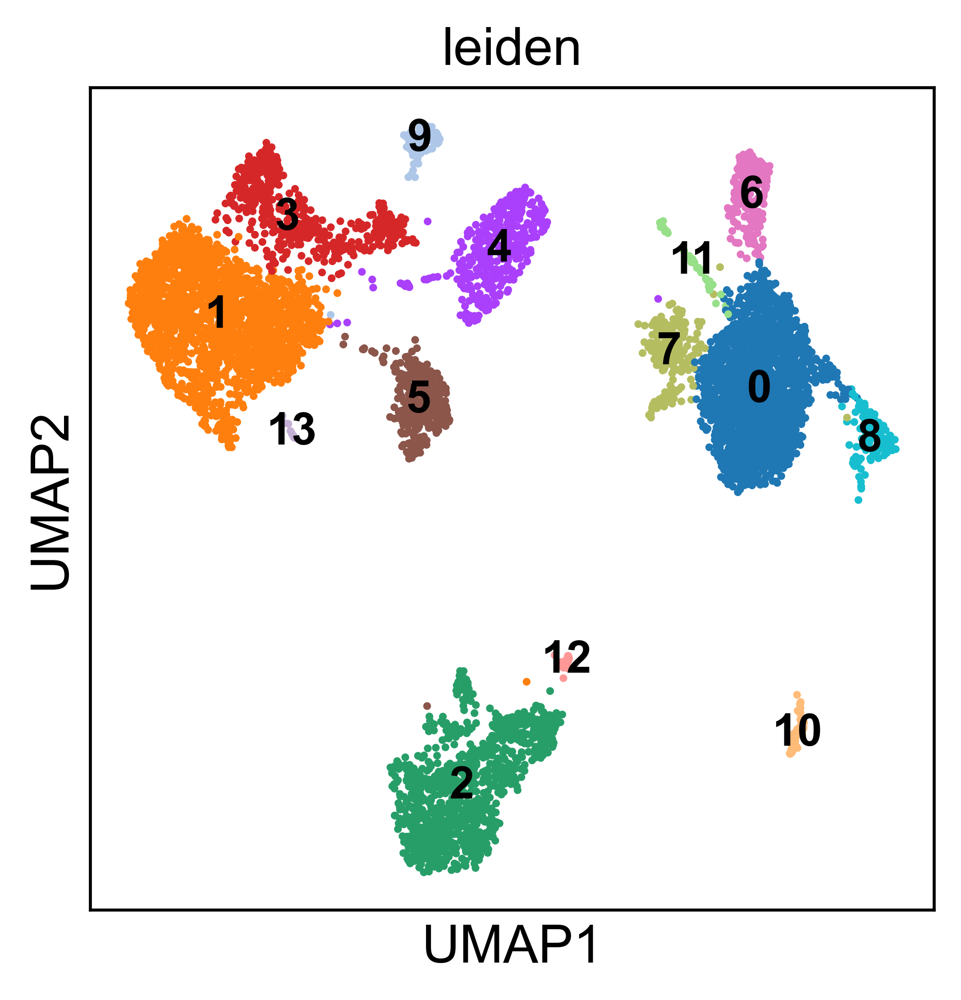

In [241]:
fig = sc.pl.umap(gex, color=['leiden'],
                legend_fontsize = 12,
                legend_loc = 'on data', save='9_leiden-clustering.png', return_fig=True)
fig.savefig(figpath + '9_leiden-clustering.png', dpi=300, bbox_inches='tight')
plt.show()

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  


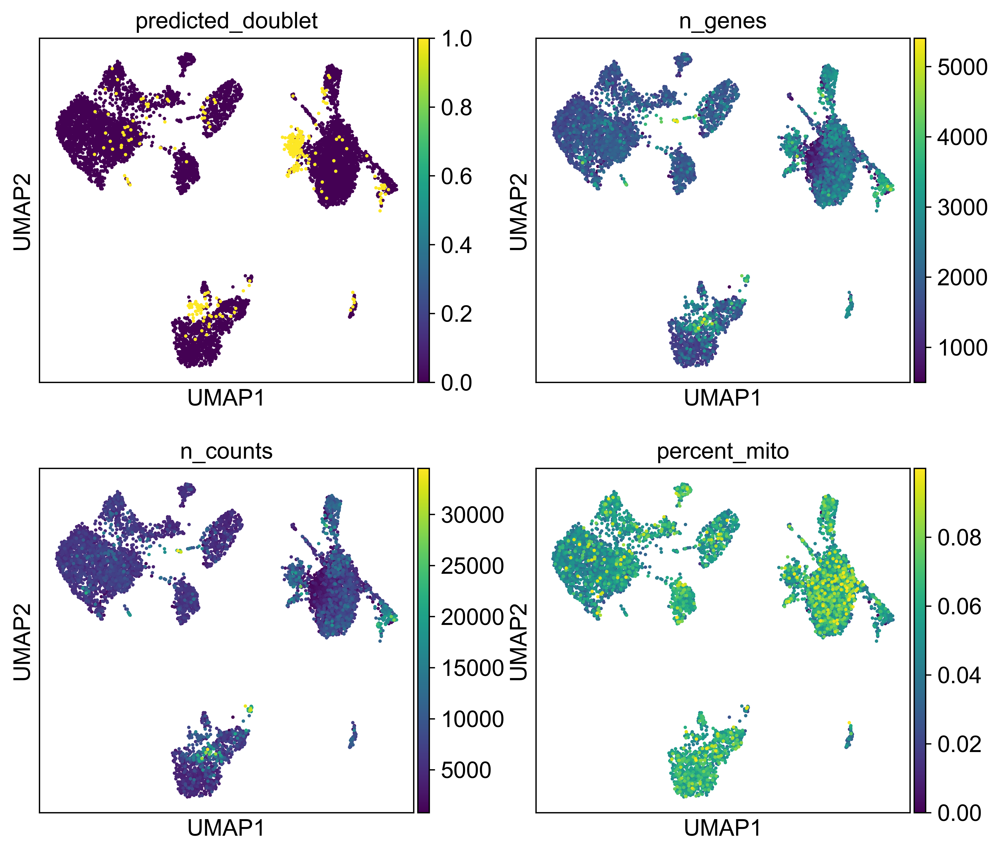

In [242]:
genes_to_plot = ['predicted_doublet','n_genes',
                'n_counts','percent_mito']

fig = sc.pl.umap(gex, color=genes_to_plot, use_raw=True,
                sort_order=True, ncols=2, save = '9_umap_metadata.png', return_fig=True)
plt.show()

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  


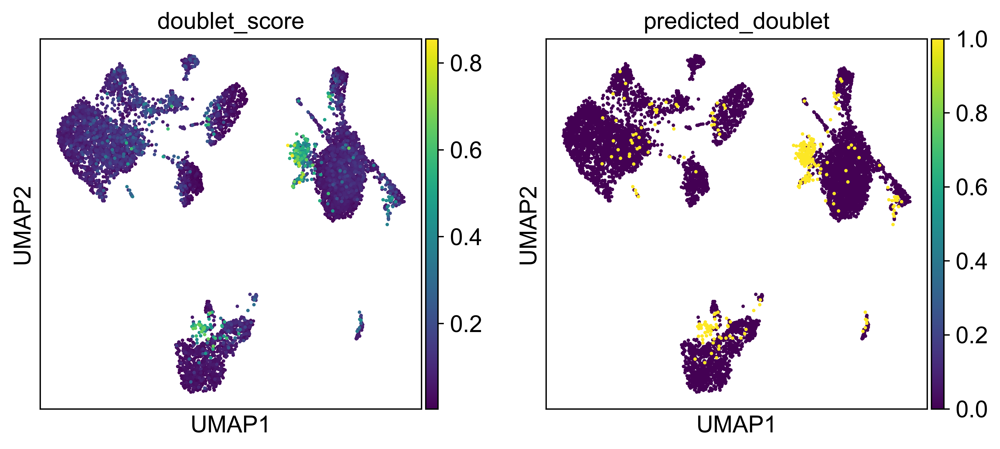

In [243]:
genes_to_plot = ['doublet_score','predicted_doublet']

fig = sc.pl.umap(gex, color=genes_to_plot, use_raw=True,
                sort_order=True, ncols=2, save='9_umap_doublets.png', return_fig=True)

plt.show()

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  


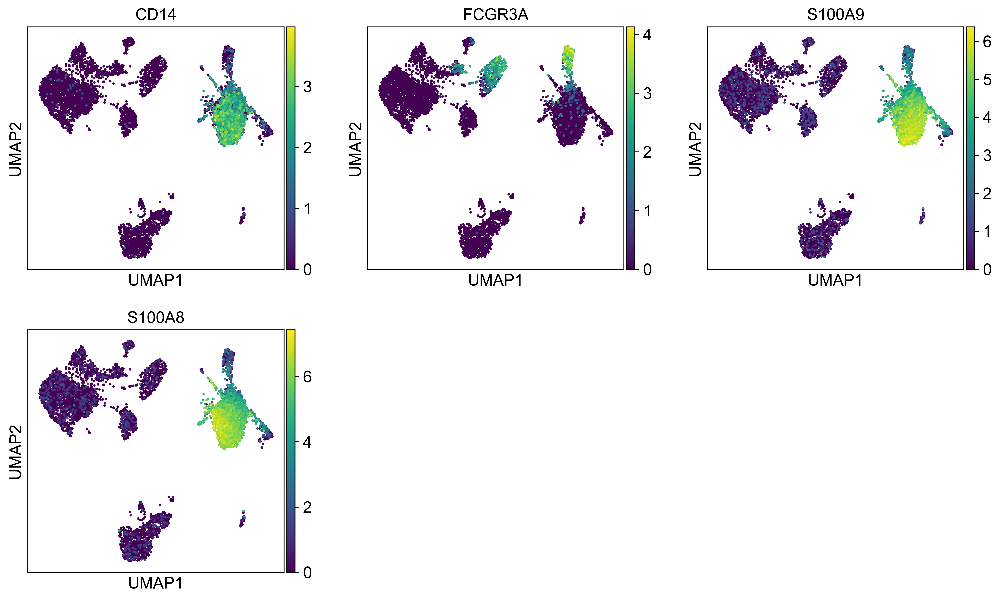

In [244]:
genes_to_plot = ['CD14','FCGR3A',
                'S100A9','S100A8']

gex2 = gex[gex.obs.predicted_doublet == False]

fig = sc.pl.umap(gex2, color=genes_to_plot, use_raw=True,
                sort_order=True, ncols=3, return_fig = True)
plt.show()

In [245]:
sc.tl.rank_genes_groups(gex, 'leiden', method='logreg',
                       n_genes=10)

sc.pl.rank_genes_groups(gex, n_genes=10, sharey=False,
                        fontsize=12,
                        save='5_marker-genes-ranking.png')

/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


/anaconda3/lib/python3.7/site-packages/scanpy/plotting/_utils.py:312: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:13: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  del sys.path[0]


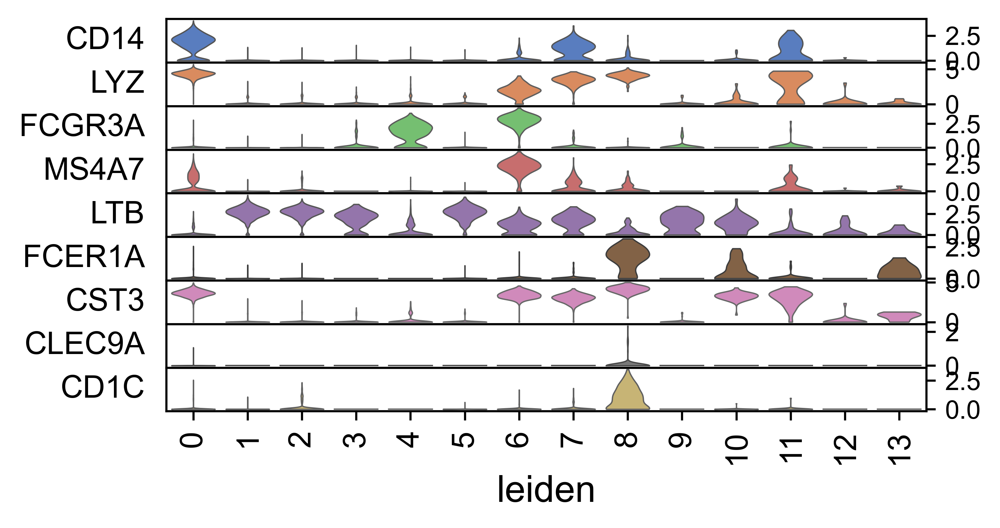

In [246]:
# since we know markers, let's make panels for some cell types that we expect to see

t_cell_panel = ['CD3E','CD8A','CD4','CCR7','EOMES','KLRD1']
b_cell_panel = ['CD79A','CD19','MS4A1']
monocyte_panel = ['CD14','LYZ','FCGR3A','MS4A7','LTB']
nk_panel = ['GNLY','NKG7']
dc_panel = ['FCER1A','CST3','CLEC9A','CD1C']
platelet_panel = ['PPBP']

# cluster 7 is DCs

sc.pl.stacked_violin(gex, monocyte_panel+dc_panel, groupby='leiden', swap_axes=True, use_raw=True)
plt.show()

In [247]:
new_cluster_names = ['Mono_CD14', #0
                    'CD4 T', #1
                    'B', #2
                    'CD8 T', #3
                    'NK', #4
                    'CD8 Tem', #5
                    'Mono_FCGR3A', #6
                    'Und1_Doublets', #7
                    'cDC', #8
                    'gd T', #9 gamma delta t cells
                    'pDCs', #10
                    'Platelets', #11
                    'Plasma B', #12
                    'Und2', #13
                    ]
gex.rename_categories('leiden', new_cluster_names)

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  """


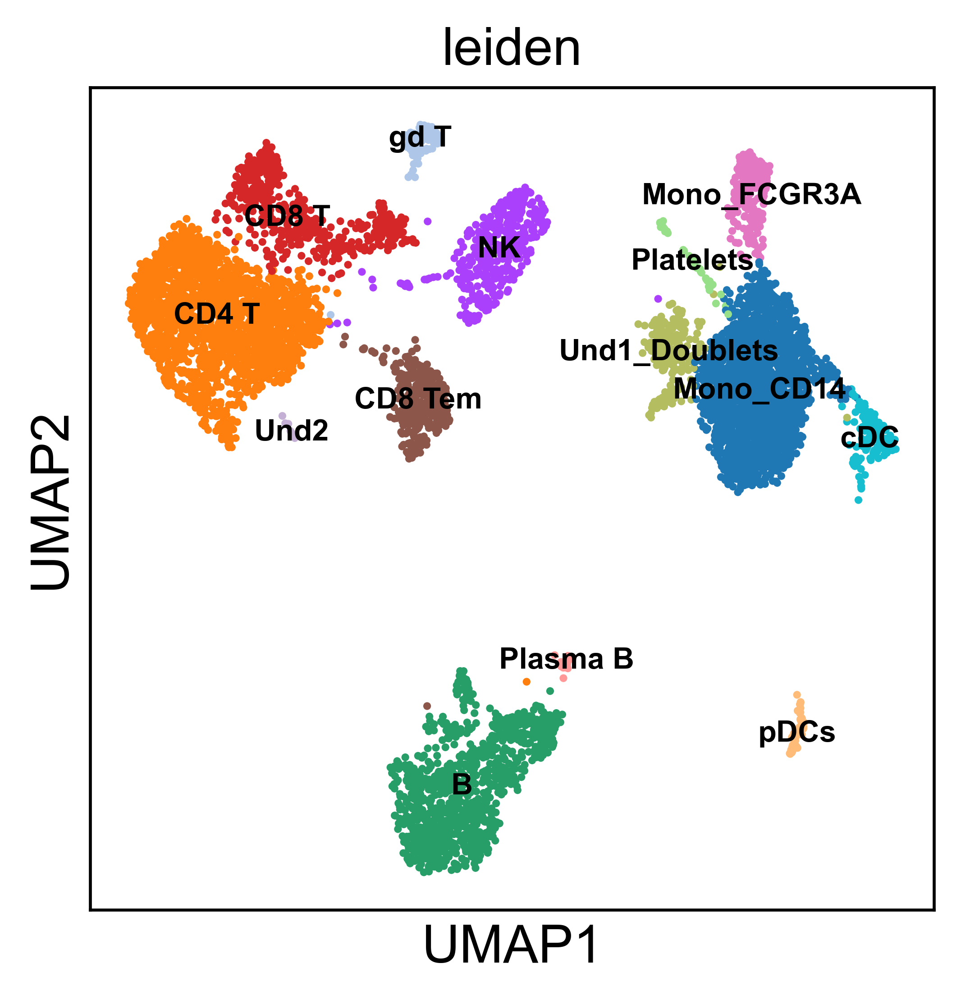

In [248]:
fig = sc.pl.umap(gex, color=['leiden'],
                legend_fontsize = 8,
                legend_loc = 'on data', save='9_leiden-clustering-renamed.png', return_fig=True)
fig.savefig(figpath + '9_leiden-clustering-renamed.png', dpi=300, bbox_inches='tight')
plt.show()

### Save the results

In [249]:
gex.write(figpath + 'scrna_wk3_processed.h5ad', compression='gzip')

... storing 'feature_types' as categorical


In [253]:
genes_to_plot = ['CD3G','CD8A','CD4',
                 'TRDV2','KLRB1','NKG7',
                 'MS4A1','JCHAIN','CD14',
                 'FCGR3A','FCER1A','PPBP',
                ]

fig = sc.pl.umap(gex, color=genes_to_plot, use_raw=True,
                sort_order=True, ncols=3,return_fig=True, color_map='Reds')

In [252]:
sc.pl.stacked_violin(gex, genes_to_plot, dendrogram=False,
                    groupby='leiden', save='8_violin.png')

plt.show()